# Simulate reservoir routine
***

**Author:** Chus Casado Rodríguez<br>
**Date:** 27-06-2024<br>

**Introduction:**<br>
This code simulates all the reservoirs included both in GloFASv4 and ResOpsUS according to the reservoir routine defined in the configuration file (attribute `simulation>model`).

The inflow time series is taken from GloFASv4 simulations, and the initial storage from the observed records.

>Note. The `Shrestha` reservoir routine requires a time series of water demand as input. Since that time series is not available, the code creates a fake demand by a transformation of the input time series.

**To do:**<br>
* [ ] When using the `Lisflood` model, some parameters could be estimated according to the records:
```Python
# storage limits
Vn_adj = get_normal_value(obs.storage) 
Vn = 1 * Vn_adj
Vtot = reservoirs.loc[grand_id, 'CAP'] * 1e6
Vf = Vtot - .2 * (Vtot - Vn_adj)

# outflow limits
if obs.outflow.isnull().all():
    Qn = reservoirs.loc[grand_id, 'normq_adj']
else:
    Qn = get_normal_value(obs.outflow) 
if obs.inflow.isnull().all():
    Qmin, Qnd = Qmin, Qnd = reservoirs.loc[grand_id, ['minq', 'ndq']]
else:
    Q100 = return_period(obs.inflow, T=100)
    Qnd = .3 * Q100
    Qmin = obs.inflow.groupby(obs.index.year).quantile(.05).mean()
Qmin = np.min([Qmin, Qn])
```

**Ideas:**<br>


In [284]:
import sys
sys.path.append('../../src/')
import os
os.environ['USE_PYGEOS'] = '0'
import numpy as np
import pandas as pd
import geopandas as gpd
from tqdm.auto import tqdm
from pathlib import Path
import yaml
import spotpy

from lisfloodreservoirs.models import get_model
from lisfloodreservoirs.utils.metrics import KGEmod
from lisfloodreservoirs.utils.utils import get_normal_value, return_period
from lisfloodreservoirs.utils.plots import plot_resops
from lisfloodreservoirs.calibration import get_calibrator, read_results

In [233]:
def create_demand(outflow: pd.Series,
                  water_stress: float = 1,
                  window: int = 8
                 ) -> pd.Series:
    """It creates a demand time series out of the outflow time series.
    First, it computes the average outflow for every day of the year (scaled with the "water_stress" coefficient), and then it applies a rolling mean of "window" width to smooth the resulting time series.
    
    Parameters:
    -----------
    outflow: pandas.Series
        Observed outflow time series
    water_stress: float
        Coefficient between average demand and average inflow
    window: integer
        Width of the rolling window used to smooth the demand time series
    
    Returns:
    --------
    demand: pandas.Series
        Time series of water demand
    """
    
    assert 0 < water_stress <= 1, "'water_stress' must be a value in the range (0, 1]"
    assert window > 0, "'window' must be an integer larger than 0"
    
    # average demand of every day of the year
    demand_d = outflow.groupby([outflow.index.month, outflow.index.day]).mean() * water_stress
    
    # smooth demand by applying a rolling mean
    buffer = int(window / 2)
    demand_d = pd.concat((demand_d.iloc[-buffer:], demand_d, demand_d.iloc[:buffer - 1]), axis=0)
    demand_d = demand_d.rolling(window, center=True).mean()
    demand_d.dropna(inplace=True)
    demand_d.index = np.arange(1, demand_d.shape[0] + 1)
    
    # define demand time series for the complete simulation period
    demand = pd.Series({date: demand_d.loc[date.dayofyear] for date in outflow.index})
    
    return demand

## Configuration

In [231]:
with open('config_mHM_2var.yml', 'r', encoding='utf8') as ymlfile:
    cfg = yaml.load(ymlfile, Loader=yaml.FullLoader)

### Paths
PATH_RESOPS = Path(cfg['paths']['ResOpsUS'])

### Reservoir model
MODEL = cfg['simulation']['model'].lower()
MODEL_CFG = cfg['simulation'].get('config', {})

# default simulation results will be saved in this path
PATH_DEF = Path(f'{MODEL}/default')
PATH_DEF.mkdir(parents=True, exist_ok=True)
print(f'Default simulation results will be saved in {PATH_DEF}')

# calibration
ALGORITHM = cfg['calibration']['algorithm'].lower()
TARGET = cfg['calibration']['target']
MAX_ITER = cfg['calibration'].get('max_iter', 1000)
COMPLEXES = cfg['calibration'].get('COMPLEXES', 4)
TRAIN_SIZE = cfg['calibration'].get('TRAIN_SIZE', 0.7)
# calibration results will be saved in this path
PATH_CALIB = Path('./') / MODEL / 'calibration' / ALGORITHM
if len(TARGET) == 1:
    PATH_CALIB = PATH_CALIB / 'univariate' / TARGET[0]
elif len(TARGET) == 2:
    PATH_CALIB /= 'bivariate'
else:
    print('ERROR. Only univariate or bivariate calibrations are supported')
    sys.exit()
PATH_CALIB.mkdir(parents=True, exist_ok=True)
print(f'Calibration results will be saved in {PATH_CALIB}')

Default simulation results will be saved in mhm\default
Calibration results will be saved in mhm\calibration\sceua\bivariate


In [3]:
variables = ['inflow', 'storage', 'outflow']

## Data

### Attributes

In [25]:
# import all tables of attributes
path_attrs = PATH_RESOPS / 'attributes'
try:
    attributes = pd.concat([pd.read_csv(file, index_col='GRAND_ID') for file in path_attrs.glob('*.csv')], axis=1, join='outer')
except Exception as e:
    raise ValueError('ERROR while reading attribute tables: {}'.format(e)) from e
print(f'{attributes.shape[0]} reservoirs in the attribute tables')

# keep only reservoirs with all observed variables
mask = pd.concat([attributes[var.upper()] == 1 for var in variables], axis=1).all(axis=1)
attributes = attributes[mask]
attributes.sort_index(axis=0, inplace=True)
print('{0} reservoirs include observed timeseris for all variables: {1}'.format(attributes.shape[0],
                                                                                *variables))

526 reservoirs in the attribute tables
231 reservoirs include observed timeseris for all variables: inflow


#### Time series

Time series of reservoirs simulated in GloFAS, as the GloFAS simulated inflow will be used as the forcing of the reservoir module.

In [144]:
path_ts = PATH_RESOPS / 'time_series' / 'csv'
timeseries = {}
bias = {}
for grand_id in tqdm(attributes.index, desc='reading time series'):
    # read time series
    file = path_ts / f'{grand_id}.csv'
    if file.is_file():
        ts = pd.read_csv(file, parse_dates=True, index_col='date')
    else:
        print(f"File {file} doesn't exist")
        continue
        
    # observed time series
    ts = ts[ts.columns.intersection(variables)].copy()
    ts[ts < 0] = np.nan
    start = np.max([ts[var].first_valid_index() for var in variables])
    end = np.min([ts[var].last_valid_index() for var in variables])
    available = (~ts[variables].isnull()).all(axis=1)
    if available.sum() > 8 * 365:
        start, end = available[available].first_valid_index(), available[available].last_valid_index()
        ts = ts.loc[start:end]
        # ts.inflow.ffill(axis=1, inplace=True)
    else:
        print(f'{grand_id:>4} discarded for lack of records: {available.sum()} days')
        continue
    
    # invert normalization
    capacity = attributes.loc[grand_id, 'CAP_MCM'] * 1e6
    ts *= capacity
    ts.iloc[:, ts.columns.str.contains('inflow')] /= (24 * 3600)
    ts.iloc[:, ts.columns.str.contains('outflow')] /= (24 * 3600)
    
    # bias between inflow and outflow
    bias[grand_id] = ts.outflow.mean() / ts.inflow.mean()
    if .7 < bias[grand_id] < 1.3:
        # save time series
        timeseries[grand_id] = ts
    else:
        print(f'{grand_id:>4} discarded for excesive bias: {bias[grand_id]:.2f}')
    
print(f'{len(timeseries)} reservoirs with timeseries')

reading time series:   0%|          | 0/231 [00:00<?, ?it/s]

 135 discarded for lack of records: 99 days
 138 discarded for lack of records: 82 days
 148 discarded for excesive bias: 0.16
 158 discarded for lack of records: 1629 days
 168 discarded for excesive bias: 0.46
 169 discarded for excesive bias: 0.06
 185 discarded for excesive bias: 0.47
 193 discarded for excesive bias: 0.59
 198 discarded for excesive bias: 0.17
 204 discarded for excesive bias: 0.53
 210 discarded for excesive bias: 0.01
 223 discarded for excesive bias: 0.49
 299 discarded for lack of records: 0 days
 338 discarded for excesive bias: 0.01
 347 discarded for lack of records: 454 days
 361 discarded for excesive bias: 0.57
 374 discarded for excesive bias: 0.49
 382 discarded for excesive bias: 0.05
 386 discarded for excesive bias: 0.42
 419 discarded for excesive bias: 0.49
 438 discarded for excesive bias: 0.31
 456 discarded for excesive bias: 0.35
 470 discarded for excesive bias: 0.46
 477 discarded for excesive bias: 0.22
 487 discarded for lack of records: 7

In [220]:
# import seaborn as sns

# import matplotlib.pyplot as plt

# bias = pd.Series(bias)

# sns.displot(bias, kind='hist', edgecolor=None, rug=True, rug_kws={'color': 'k'});
# plt.xlabel(r'${\overline{O}  /  \overline{I}}$');

## Reservoir routine
### Simulate all reservoirs

simulating reservoir:   0%|          | 0/167 [00:00<?, ?it/s]

E:\casadje\GitHub\lisflood-reservoirs\notebook\ResOpsUS\../../src\lisfloodreservoirs\utils\plots.py:174: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=kwargs.get('figsize', (20, 6)))


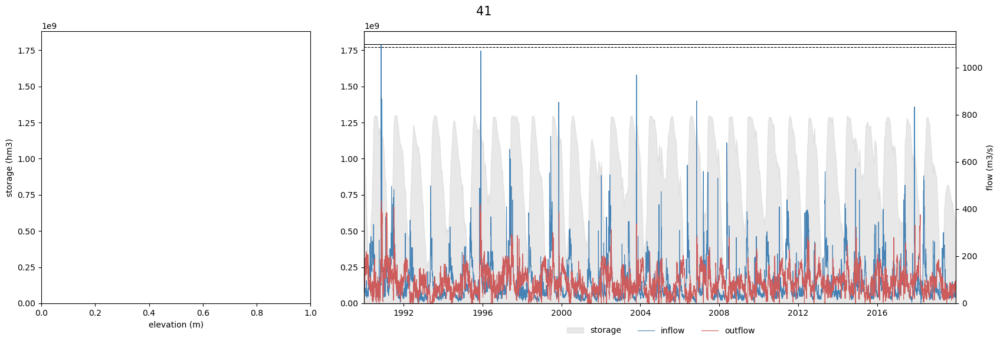

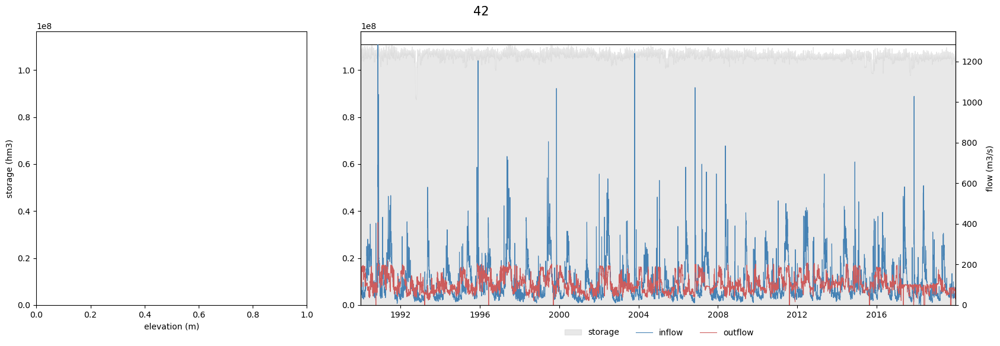

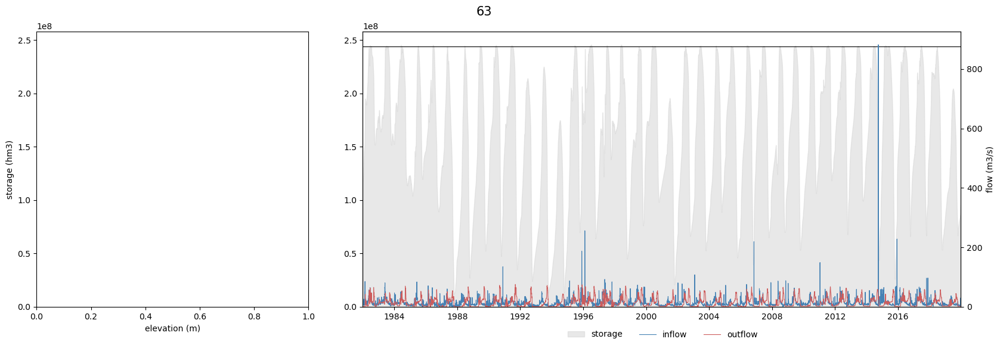

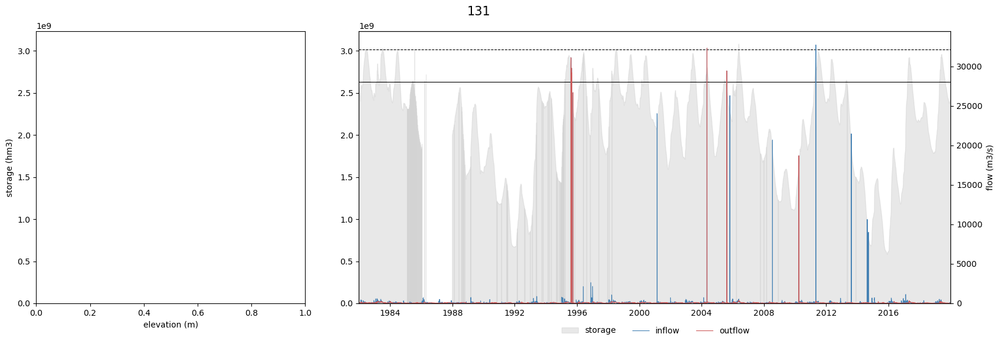

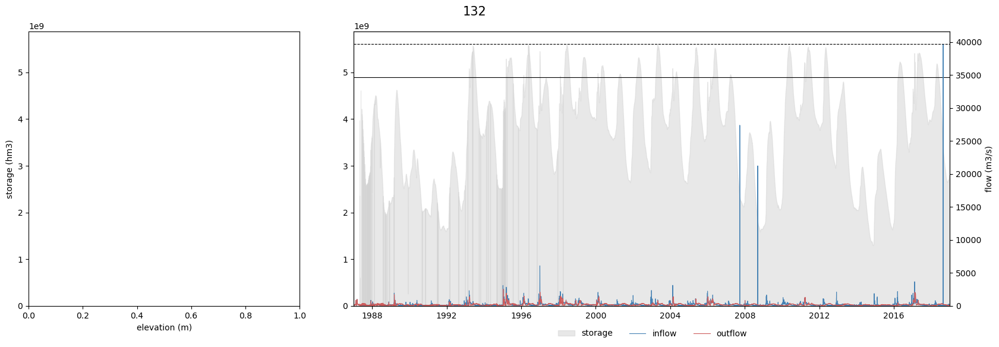

...

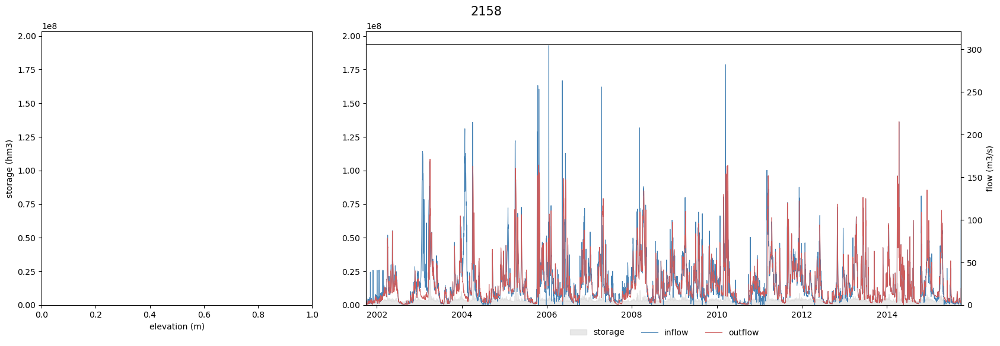

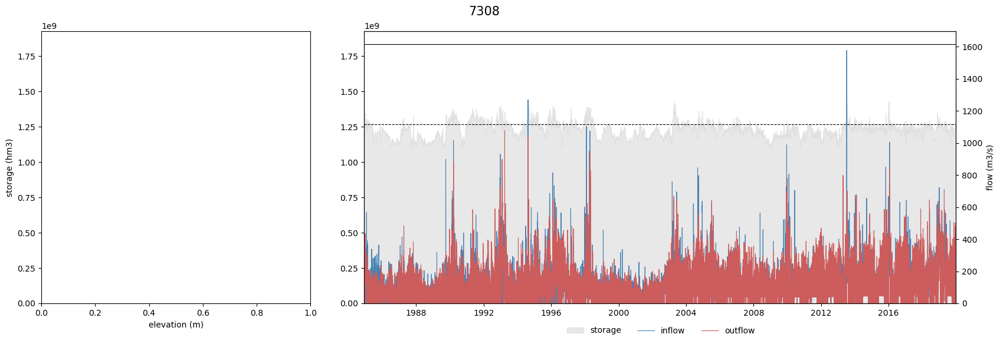

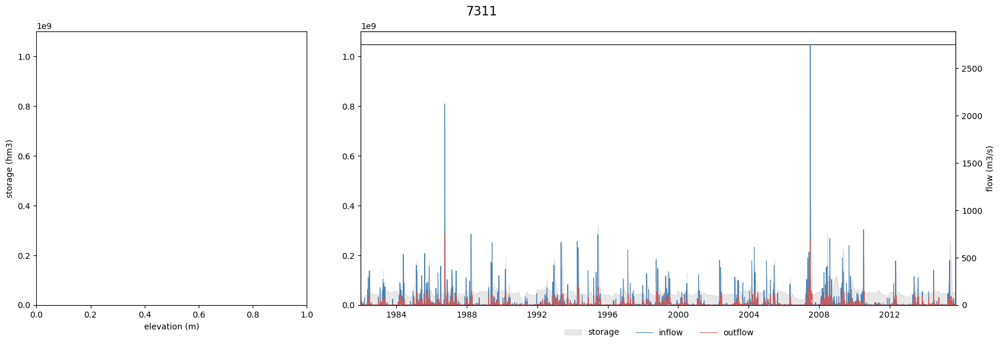

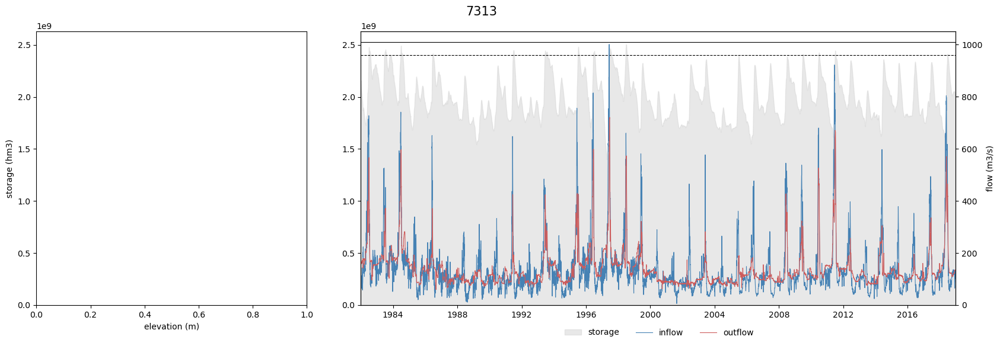

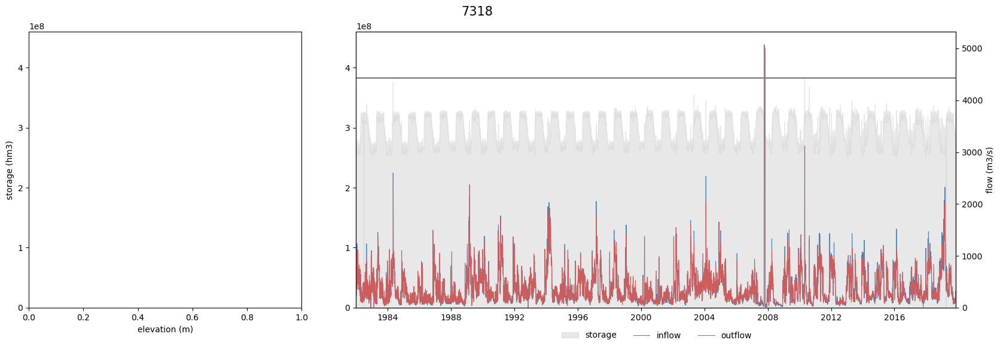

In [290]:
id_def = list(np.unique([int(file.stem.split('_')[0]) for file in PATH_DEF.glob('*performance.csv')]))
id_calib = list(np.unique([int(file.stem.split('_')[0]) for file in PATH_CALIB.glob('*performance.csv')]))

for grand_id, obs in tqdm(timeseries.items(), desc='simulating reservoir'): # 146 #302 #273 #236 #227
    
    # obs = timeseries[grand_id]
    obs.inflow.ffill(inplace=True)

    # # storage limits (m3)
    # Vtot, Vmin = attributes.loc[grand_id, ['CAP_MCM', 'Vmin']]
    # Vtot *= 1e6
    # Vmin *= Vtot
    # # outflow limits (m3/s)
    # Qmin = attributes.loc[grand_id, 'Qmin']
    
    # plot observed time series
    plot_resops(obs.storage,
                None,
                obs.inflow,
                obs.outflow,
                attributes.loc[grand_id, ['CAP_MCM', 'CAP_GLWD']].values * 1e6,
                title=grand_id,
                save=PATH_DEF / f'{grand_id}_raw_lineplot.jpg'
               )
        
    # SIMULATION WITH DEFAULT PARAMETERS
    # ----------------------------------
    
    if grand_id not in id_def:
    
        # declare the reservoir
        reservoir_kwargs = {'Vmin': max(0, obs.storage.min()), #Vmin,
                            'Vtot': obs.storage.max(), #Vtot
                            'Qmin': max(0, obs.outflow.min()), #Qmin,
                            'avg_inflow': obs.inflow.mean(),
                            'avg_demand': demand.mean(),
                            'gamma': obs.storage.quantile(.9) / obs.storage.max()}
        res = get_model(MODEL, **reservoir_kwargs)

        # export default parameters
        with open(PATH_DEF / f'{grand_id}_default_parameters.yml', 'w') as file:
            yaml.dump(res.get_params(), file)

        # simulate the reservoir
        simulation_kwargs = {'demand': create_demand(obs.outflow,
                                                     water_stress=min(1, bias[grand_id]),
                                                     window=28)}
        sim_def = res.simulate(inflow=obs.inflow, Vo=obs.storage.iloc[0], **simulation_kwargs)

        # analyse simulation
        performance = pd.DataFrame(index=['KGE', 'alpha', 'beta', 'rho'], columns=variables)
        for var in performance.columns:
            try:
                performance[var] = KGEmod(obs[var], sim[var])
            except:
                continue
        performance.to_csv(PATH_DEF / f'{grand_id}_performance.csv', float_format='%.3f')

        res.scatter(sim_def,
                    obs,
                    norm=False,
                    title=f'grand_id: {grand_id}',
                    save=PATH_DEF / f'{grand_id}_scatter.jpg',
                   )

        res.lineplot({#'GloFAS': glofas, 
                      'sim': sim_def},
                     obs,
                     figsize=(12, 6),
                     save=PATH_DEF / f'{grand_id}_line.jpg',
                   )

In [ ]:
plot_resops()

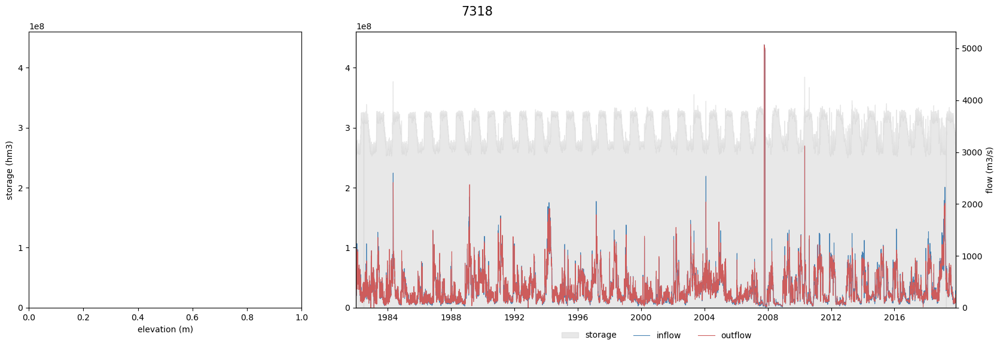

In [218]:
    # CALIBRATION
    # -----------

    dbname = f'{PATH_CALIB}/{grand_id}_samples'

    # initialize the calibration setup of the LISFLOOD reservoir routine
    setup = get_calibrator(MODEL,
                           inflow=obs.inflow,
                           storage=obs.storage, 
                           outflow=obs.outflow,
                           Vmin=obs.storage.min(), #Vmin,
                           Vtot=obs.storage.max(), #Vtot,
                           Qmin=obs.outflow.min(), #Qmin,
                           target=TARGET,
                           obj_func=KGEmod,
                           **{'demand': demand})

    # define the sampling method
    sceua = spotpy.algorithms.sceua(setup, dbname=dbname, dbformat='csv', save_sim=False)

    # start the sampler
    sceua.sample(MAX_ITER, ngs=COMPLEXES, kstop=3, pcento=0.01, peps=0.1)

    # declare the reservoir with optimal parameters
    results, reservoir_kwargs = read_results(f'{dbname}.csv')
    reservoir_kwargs.update({'Vmin': obs.storage.min(),
                             'Vtot': obs.storage.max(), #Vtot,
                             'Qmin': obs.outflow.min(),
                             'avg_inflow': obs.inflow.mean(),
                             'avg_demand': demand.mean()})
    res = get_model(MODEL, **reservoir_kwargs)
    
    # export calibrated parameters
    with open(PATH_CALIB / f'{grand_id}_optimal_parameters.yml', 'w') as file:
        yaml.dump(res.get_params(), file)

    # simulate the reservoir
    simulation_kwargs = {'demand': demand}
    sim_cal = res.simulate(inflow=obs.inflow, Vo=obs.storage.iloc[0], **simulation_kwargs)

    # performance
    performance = pd.DataFrame(index=['KGE', 'alpha', 'beta', 'rho'], columns=obs.columns)
    for var in performance.columns:
        try:
            performance[var] = KGEmod(obs[var], sim_cal[var])
        except:
            continue
    performance.to_csv(PATH_CALIB / f'{grand_id}_performance.csv', float_format='%.3f')
        
    # analyse results
    res.scatter(sim_cal,
                obs,
                norm=False,
                title=f'grand_id: {grand_id}',
                save=PATH_CALIB / f'{grand_id}_scatter.jpg',
               )
    res.lineplot({'default': sim_def, 
                  'calibrated': sim_cal},
                 obs,
                 figsize=(12, 6),
                 save=PATH_CALIB / f'{grand_id}_line.jpg',
               )